<a href="https://colab.research.google.com/github/alechain/transcrippcion/blob/main/transcribe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instalamos las librerias necesarias

In [14]:
!pip uninstall tiktoken -y
!pip install tiktoken==0.3.1


Found existing installation: tiktoken 0.3.3
Uninstalling tiktoken-0.3.3:
  Successfully uninstalled tiktoken-0.3.3
  Using cached tiktoken-0.3.1-cp38-cp38-macosx_10_9_x86_64.whl (734 kB)


In [1]:

# Para instalas descomentar
!pip install git+https://github.com/openai/whisper.git -q
!pip install openai
!pip install pytube

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
openai-whisper 20230314 requires tiktoken==0.3.1, but you have tiktoken 0.3.3 which is incompatible.


In [3]:
!pip install --upgrade numpy==1.21

  Using cached numpy-1.21.0-cp38-cp38-macosx_10_9_x86_64.whl (16.9 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.22.4
    Uninstalling numpy-1.22.4:
      Successfully uninstalled numpy-1.22.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
daal4py 2021.5.0 requires daal==2021.4.0, which is not installed.
openai-whisper 20230314 requires tiktoken==0.3.1, but you have tiktoken 0.3.3 which is incompatible.
pyldavis 3.4.0 requires numpy>=1.22.0, but you have numpy 1.21.0 which is incompatible.
tensorboard 2.7.0 requires google-auth-oauthlib<0.5,>=0.4.1, but you have google-auth-oauthlib 0.7.1 which is incompatible.


In [5]:
import numpy as np

In [6]:
np.__version__

'1.21.0'

# Importamos las librerias necesarias

In [55]:
import whisper
import numpy  as np
import pandas as pd
import openai
import os
import sys
import subprocess
import requests
import regex as re
from pytube import YouTube



## Creamos unas función para descargar videos de youtube ( se puede cargar el video mp4 directo en el enviroment) y lo guardamos con el nombre de video.mp4

In [57]:
!pip install --upgrade pytube


In [58]:
!pip install youtube-dl
!pip install pafy

In [61]:
yt = YouTube(url,use_oauth=True, allow_oauth_cache=True)


In [68]:
!pip install yt_dlp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 2.3 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.6/193.6 kB 2.6 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 3.8 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 421.1/421.1 kB 3.7 MB/s eta 0:00:00a 0:00:01


In [69]:

from yt_dlp import YoutubeDL


In [71]:
with YoutubeDL() as ydl:
    ydl.download('https://www.youtube.com/watch?v=Ve-Ji7kockc')

[youtube] Extracting URL: https://www.youtube.com/watch?v=Ve-Ji7kockc
[youtube] Ve-Ji7kockc: Downloading webpage
[youtube] Ve-Ji7kockc: Downloading android player API JSON
[info] Ve-Ji7kockc: Downloading 1 format(s): 248+251
[dashsegments] Total fragments: 31
[download] Destination: Horacio Rodríguez Larreta charló mano a mano con Alejandro Fantino ｜ Entrevista completa [Ve-Ji7kockc].f248.webm
[download] 100% of  308.99MiB in 00:01:13 at 4.18MiB/s                   
[dashsegments] Total fragments: 3
[download] Destination: Horacio Rodríguez Larreta charló mano a mano con Alejandro Fantino ｜ Entrevista completa [Ve-Ji7kockc].f251.webm
[download] 100% of   25.38MiB in 00:00:04 at 5.47MiB/s               
[Merger] Merging formats into "Horacio Rodríguez Larreta charló mano a mano con Alejandro Fantino ｜ Entrevista completa [Ve-Ji7kockc].webm"
Deleting original file Horacio Rodríguez Larreta charló mano a mano con Alejandro Fantino ｜ Entrevista completa [Ve-Ji7kockc].f251.webm (pass -k to 

In [72]:
!pip install moviepy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 388.3/388.3 kB 2.6 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.5/22.5 MB 3.6 MB/s eta 0:00:0000:0100:01m
  Created wheel for moviepy: filename=moviepy-1.0.3-py3-none-any.whl size=110743 sha256=e3f05217333171043cbda79778511a37bbf416098aa0fcbc5f869918a239b00e
  Stored in directory: /Users/achain/Library/Caches/pip/wheels/e4/a4/db/0368d3a04033da662e13926594b3a8cf1aa4ffeefe570cfac1
Successfully built moviepy
  Attempting uninstall: decorator
    Found existing installation: decorator 5.1.1
    Uninstalling decorator-5.1.1:
      Successfully uninstalled decorator-5.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
spyder 5.1.5 requires pyqt5<5.13, which is not installed.
spyder 5.1.5 requires pyqtwebengine<5.13, which is not installed.


In [73]:
from moviepy.editor import VideoFileClip

def convert_webm_to_mp3(webm_file, mp3_file):
    video = VideoFileClip(webm_file)
    audio = video.audio
    audio.write_audiofile(mp3_file)

# Provide the paths of the WebM and MP3 files
webm_file_path = "video.webm"
mp3_file_path = "video.mp3"

# Call the conversion function
convert_webm_to_mp3(webm_file_path, mp3_file_path)

MoviePy - Writing audio in video.mp3


MoviePy - Done.


In [82]:
url='https://www.youtube.com/watch?v=2pkbSnt2Xzw'
yt = YouTube(url,use_oauth=True, allow_oauth_cache=True)
stream_url = yt.streams.filter(progressive=True, file_extension='mp4').order_by('resolution').desc().first().url

In [133]:
url='https://www.youtube.com/watch?v=R_ZYZW2edjQ'
yt = YouTube(url,use_oauth=True, allow_oauth_cache=True)
stream_url = yt.streams.filter(progressive=True, file_extension='mp4').order_by('resolution').desc().first().url
response = requests.get(stream_url)
with open("video.mp4", "wb") as f:
    f.write(response.content)

### Ahora lo que viene aca es una funcioncita que basicamente convierte en fomato mp3 el audio del video que le pases (en formato mp4), para eso se usa la función ffmpeg que es una librería para gestion de videos 

In [42]:
def video2mp3(video_file, output_ext="mp3"):
    filename, ext = os.path.splitext(video_file)
    subprocess.call(["ffmpeg", "-y", "-i", video_file, f"{filename}.{output_ext}"], 
                    stdout=subprocess.DEVNULL,
                    stderr=subprocess.STDOUT)
    return f"{filename}.{output_ext}"
#aca ejecutamos la funcion con el nombre del video que creamos guardamos 
#antes
#input_video = 'video.mp4'
#audio_file = video2mp3(input_video)


In [134]:
input_video = 'video.mp4'
audio_file = video2mp3(input_video)

In [135]:
audio_file = 'video.mp3'

### Con esta funcion podes escuchar el audio en el notebook para comprobar que este bien (una boludez pero sirve de testeo)

In [86]:
from IPython.display import Audio
Audio(audio_file)

### Aca importamos e instanciamos el algoritmo pre-entrenado de Whisper en size "small", esto particularmente porque se va. a correr en local se lo hace en tamaño "small". Mientras mayor sea el tamaño elegido (el tamaño importa aca) mejor serán las transcripciones y las traducciones por la cantidad de parámetros que tenga el modelo, pero a la vez mayores serán los requerimientos para poder correrlo. En mi Mac me aguante sin reventarme la memoria y el CPU hasta el tamaño small (promedio diria yo). 

### Te dejo una tablita igual con los tamaños disponibles por si querés probar otro valor (cambiar donde dice "small" por "medium" "base" et...)


| Size   | Parameters | English-only model | Multilingual model |
|--------|------------|--------------------|-------------------|
| tiny   | 39 M       |        ✓           |         ✓         |
| base   | 74 M       |        ✓           |         ✓         |
| small  | 244 M      |        ✓           |         ✓         |
| medium | 769 M      |        ✓           |         ✓         |
| large  | 1550 M     |                     |         ✓         |


In [11]:
import whisper

model = whisper.load_model("small",languge='es')

## Una vez instanciado el modelo en "model" se crea una función para retornar el resultado

In [89]:
def transcribe(audio):
    result = model.transcribe(audio, fp16=False)
    return result

## Ahora si ejecutamos la función

In [136]:
result = transcribe(audio_file)


In [137]:
result

{'text': ' La satisfacción es muy grande, para mí es emocionante. En 16 años de gestión le mejoramos la vida a la gente. Por eso quiero agradecer. Primero gracias a los porteños, gracias por cada encuentro, por cada reunión, por cada recorrida, por cada café que compartimos. Gracias por acercarse siempre y contarme mirándome a los ojos lo que necesitaban. Hoy algunos de ustedes están acá en el recinto, están representando los 3 millones de porteños. Están acompañándome en esta última rendición de cuentas que me toca hacer todos los años. Siempre de cara a la gente, de cara a la gente que es para quienes trabajamos incansablemente todos los días hace más de 15 años. Gracias también a los bloques de la legislatura por construir un espacio de diálogo y convivencia democrática. Donde las diferencias existen, son democráticas, pero nunca atentan contra la responsabilidad de mejorar la vida a la gente. Gracias a Mauricio, con quien iniciamos estas transformaciones en el 2007 y que pudimos co

In [119]:
Audio(audio_file)

NameError: name 'audio_recortado' is not defined

In [3]:
result=!whisper audio.mp3 --model small --language es

^C


In [77]:
result

{'text': " Gracias por venir a la ciudad. Gracias por la invitación, Ale. Vamos a echarla un rato y después vamos a estar conversando con Francisco Luis Mora, le dicen Luchín a Francisco. Es el papá de Martín Mora Negretti, al chiquito de él. Lo asesinaron en Mar del Plata el día del padre. ¿Se acuerdan que lo acuchiciaron en el pecho, estos unos menores? Y nada, apareció el papá, se comunicó conmigo por teléfono, se hace un tiempo, te lo cuento vos. Y le digo, dale, venite. Me dice, tengo una... Venite, venite. De Mar del Plata, tiene una despensa. Pero bueno, eso va a ser un ratito. Así que vamos a hablar un poco a nosotros dos. ¿Cómo andas, Horacio? Te estaba apuntando de que a veces... La verdad, lo vi, lo vi. Te es terrible, hermano. La vida, viste... Terrible. Pero vos sabes que me llegó porque... No sé cómo me lo contó Horacio. Me lo contó de un lugar... No, no, no. ¿Qué tiene que hacer el tipo acá? Hablando conmigo al aire, hablando de la muerte lijo. O sea, tendré que la vida 

In [137]:
result_2=!whisper audio_recortado.mov --model small --language es

In [138]:
data=pd.DataFrame(result_2)

In [139]:
data=data[0].str.split(']',expand=True)

In [140]:
data.columns=('time','text')

In [141]:
data

,time,text
0,[00:00.000 --> 00:08.000,"Bueno, continuando, entonces,"
1,[00:08.000 --> 00:12.000,"con lo programado, tenemos la"
2,[00:12.000 --> 00:16.000,"presentación de Panamerican,"
3,[00:16.000 --> 00:19.000,la presentación va a ser realizada
4,[00:19.000 --> 00:22.000,"por Martín Ruiz, quien ya conocemos"
5,[00:22.000 --> 00:25.000,"del año pasado, estado con nosotros,"
6,[00:25.000 --> 00:29.000,"y Diego Zobro, el título de la"
7,[00:29.000 --> 00:32.000,"presentación de Panamerican,"
8,[00:32.000 --> 00:35.000,con modelos basados en árboles.
9,[00:35.000 --> 00:38.000,"Bueno, ¿están listos, Diego?"


In [142]:
data


,time,text
0,[00:00.000 --> 00:08.000,"Bueno, continuando, entonces,"
1,[00:08.000 --> 00:12.000,"con lo programado, tenemos la"
2,[00:12.000 --> 00:16.000,"presentación de Panamerican,"
3,[00:16.000 --> 00:19.000,la presentación va a ser realizada
4,[00:19.000 --> 00:22.000,"por Martín Ruiz, quien ya conocemos"
5,[00:22.000 --> 00:25.000,"del año pasado, estado con nosotros,"
6,[00:25.000 --> 00:29.000,"y Diego Zobro, el título de la"
7,[00:29.000 --> 00:32.000,"presentación de Panamerican,"
8,[00:32.000 --> 00:35.000,con modelos basados en árboles.
9,[00:35.000 --> 00:38.000,"Bueno, ¿están listos, Diego?"


In [144]:
# Regular expression pattern
pattern = r'((\d{2}:)?\d{2}:\d{2}\.\d{3}).*(\d{2}:\d{2}:\d{2}\.\d{3})'
pattern = r'(\d{2}:\d{2}:\d{2}\.\d{3})\s*-->\s*(\d{2}:\d{2}:\d{2}\.\d{3})'
pattern = r'(\d{2}:\d{2}:\d{2}\.\d{3})\s*-->\s*(\d{2}:\d{2}:\d{2}\.\d{3})'
data[['start_timestamp', 'end_timestamp']] = data['time'].str.extract(pattern)


In [102]:
len(data['time'][3000])

30

In [145]:
pattern = r'(\d{2}:\d{2}\.\d{3})\s*-->\s*(\d{2}:\d{2}\.\d{3})'
data[['start_timestamp_2', 'end_timestamp_2']] = data['time'].str.extract(pattern)


In [109]:
~data['start_timestamp'].isna()

0       False
1       False
2       False
3       False
4       False
        ...  
3316     True
3317     True
3318     True
3319     True
3320     True
Name: start_timestamp, Length: 3321, dtype: bool

In [146]:
condition=[data['start_timestamp'].isna(),~data['start_timestamp'].isna()]
result=[data['start_timestamp_2'],data['start_timestamp']]

data['time_start']=np.select(condition,result)

condition=[data['end_timestamp'].isna(),~data['end_timestamp'].isna()]
result=[data['end_timestamp_2'],data['end_timestamp']]

data['time_end']=np.select(condition,result)



In [147]:
pd.set_option('display.max_rows', None)

#data_mesh_data=data[['text','time_start','time_end']][32:858]

In [157]:
data[~data['text'].isna()][['text']].apply(lambda x: ' '.join(x) )['text']

'  Bueno, continuando, entonces,   con lo programado, tenemos la   presentación de Panamerican,   la presentación va a ser realizada   por Martín Ruiz, quien ya conocemos   del año pasado, estado con nosotros,   y Diego Zobro, el título de la   presentación de Panamerican,   con modelos basados en árboles.   Bueno, ¿están listos, Diego?   Sí, estamos listos.   Perfecto.   ¿A Martín?   Martín se estaba uniendo.   Bueno, comparto.   Ok.   Muchas gracias por la invitación.   Vamos a estar hablando de   predicción de ventas en estaciones de   servicio como modelos basados en árboles.   Vamos de una clasión, vamos a   predecir cuánto va a vender una estación   que todavía no existe.   Esa es lo que tiene interesante.   Y comenzamos, hablando un poco   de otra acción de la colación,   una viñeta clásica que nos muestra   alguien que está buscando su   billetera abajo de un farol   y se le acerca a un policía y le   pregunta si es ahí donde le había   perdido, le dice no, la perdí en el   par

In [138]:
start=[]
end=[]
text=[]
for i in range(len(result['segments'])):
  start.append(result['segments'][i]['start'])
  end.append(result['segments'][i]['end'])
  text.append(result['segments'][i]['text'])

  

In [139]:
datos=pd.DataFrame()
datos['start']=start
datos['end']=end
datos['text']=text



In [140]:
datos

,start,end,text
0,0.0,5.2,"La satisfacción es muy grande, para mí es emo..."
1,5.2,11.0,En 16 años de gestión le mejoramos la vida a ...
2,11.0,25.0,Por eso quiero agradecer.
3,26.0,35.0,"Primero gracias a los porteños, gracias por c..."
4,35.0,41.0,Gracias por acercarse siempre y contarme mirá...
...,...,...,...
580,3070.0,3072.0,"que es el discurso anti-grieta,"
581,3072.0,3074.0,volvió a insistir sobre esto
582,3074.0,3077.0,y sobre la necesidad de conciliación
583,3077.0,3078.0,y concordia entre los argentinos.


In [52]:
result['segments'][0]['start']

0.0

In [19]:
# abrimos el file con el nombre de transcribe
file = open('transcribe.txt', 'w')

# escribimos el resultado dentro del file
file.write(result['text'])

# lo cerramos
file.close()

In [141]:
datos.to_csv('larreta_5.csv', index=False)

# Finalizado, el archivo transcribe.txt contiene el texto transcripto del video

In [22]:
!pip install pyLDAvis

     |████████████████████████████████| 2.6 MB 2.5 MB/s eta 0:00:01
     |████████████████████████████████| 19.8 MB 4.2 MB/s eta 0:00:01    |███████████▊                    | 7.2 MB 402 kB/s eta 0:00:32
     |████████████████████████████████| 297 kB 3.1 MB/s eta 0:00:01
     |████████████████████████████████| 17.6 MB 814 kB/s eta 0:00:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.21.5
    Uninstalling numpy-1.21.5:
      Successfully uninstalled numpy-1.21.5
  Attempting uninstall: joblib
    Found existing installation: joblib 1.1.0
    Uninstalling joblib-1.1.0:
      Successfully uninstalled joblib-1.1.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
daal4py 2021.5.0 requires daal==2021.4.0, which is not installed.
tensorboard 2.7.0 requires google-auth-oauthlib<0.5,>=0.4.1, but you have google-auth-oauthlib 0.7.1 which is incomp

In [20]:
!pip install spacy

     |████████████████████████████████| 6.8 MB 1.6 MB/s eta 0:00:01
     |████████████████████████████████| 181 kB 4.0 MB/s eta 0:00:01
     |████████████████████████████████| 107 kB 1.6 MB/s eta 0:00:01
     |████████████████████████████████| 850 kB 1.1 MB/s eta 0:00:01
     |████████████████████████████████| 490 kB 1.8 MB/s eta 0:00:01
     |████████████████████████████████| 48 kB 2.0 MB/s eta 0:00:01
     |████████████████████████████████| 56 kB 2.0 MB/s eta 0:00:01
     |████████████████████████████████| 6.1 MB 4.0 MB/s eta 0:00:01
  Attempting uninstall: smart-open
    Found existing installation: smart-open 5.1.0
    Uninstalling smart-open-5.1.0:
      Successfully uninstalled smart-open-5.1.0


In [147]:
import re
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# spacy 
import spacy

# Plotting 
import pyLDAvis
#import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

In [15]:
result['text']

' La verdad es que primero quiero agradecerles, nos escuchamos a todos y a todas, algunos más efusivos, otros un poco más moderados, pero todos con la buena leche de estos años que venimos trabajando. Y les agradezco porque sé que a lo largo de estos meses, desde el momento en que me tocó hacerme cargo del Ministerio de Economía, con todo lo que eso significaba, tal vez poco me alejé de la política, pero la responsabilidad hoy central, en un país que vivió un endeudamiento feroz y que de alguna manera es una herencia que la va a perseguir a la Argentina por muchos años, en un país que le tocó enfrentar una pandemia como el resto del mundo, pero sin crédito, y eso fue todo emisión y esa bola de pesos que hoy en gran parte explica la inflación por falta de crédito multilateral y por falta de crédito soberano, porque Argentina estaba renegociando su deuda y tardó una eternidad. De alguna manera también lo que vino después es la guerra, los precios internacionales, cómo impactaron, y final

In [152]:
import nltk

In [153]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/achain/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [27]:
!pip install spacy && python -m spacy download es_core_news_sm


     |████████████████████████████████| 12.9 MB 8.4 MB/s eta 0:00:01
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


In [149]:
total['text']

0       Estamos con Horacio Ro... ¿Qué hace eso Horacio?
1                                    Horacio, las por...
2                                      ¿Cómo están? Bien
3                                    Viste Luis, subiste
4       Bien, está bien, te ves el micrófono por el d...
                             ...                        
202                       nos quedan 20 días de trabajo,
203                               porque el 1º de abril,
204     con competitividad cambiaria que pone el Esta...
205     tenemos que tener más vino argentino en el mu...
206                                      Muchas gracias.
Name: text, Length: 4834, dtype: object

In [150]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(total['text']))

print(data_words)

[['estamos', 'con', 'horacio', 'ro', 'que', 'hace', 'eso', 'horacio'], ['horacio', 'las', 'por'], ['como', 'estan', 'bien'], ['viste', 'luis', 'subiste'], ['bien', 'esta', 'bien', 'te', 'ves', 'el', 'microfono', 'por', 'el', 'de', 'los', 'abrigulos'], ['si', 'perfecto', 'si', 'ahi', 'esta'], ['asi', 'hablan', 'los', 'microfones', 'como', 'es', 'la', 'horacio'], ['bien', 'bien', 'trabajando', 'mucho', 'pero', 'bien', 'intenso'], ['te', 'veo', 'de', 'aca', 'para', 'alla', 'tengo'], ['si'], ['menos', 'mas', 'que', 'bien', 'eso', 'sabia', 'que', 'venia', 'ayer', 'dije', 'que', 'iba', 'estar', 'aca'], ['si', 'yo', 'cumplo', 'va', 'bien'], ['si', 'esta', 'muy', 'bien', 'me', 'parece', 'barro', 'mi', 'hijo'], ['esta', 'manana', 'anunciamos', 'viste', 'que', 'sacamos', 'el', 'impuesto', 'las', 'tarjetas', 'de', 'credito'], ['lo', 'eliminamos', 'totalmente'], ['yo', 'habia', 'dicho', 'que', 'cuando', 'la', 'corte', 'nos', 'devolviese', 'los', 'fondos'], ['que', 'nos', 'acuerdan', 'los', 'anos']

In [154]:
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]


In [155]:
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

In [156]:
# Spanish text analysis tools 
stopwords = set(nltk.corpus.stopwords.words("spanish"))
nlp = spacy.load("es_core_news_sm")
def normalize_tokenize_lemmatize(text):
    doc = nlp(text)
    VALID_POS = {'NOUN', 'ADJ', 'VERB', 'ADV'}
    # Avoid empty word in beggining with doc[1:]
    return [
        word.lemma_ for word in doc if word.lemma_ not in stopwords
        and word.pos_ in VALID_POS
        ]
# This step may take a few minutes
total['text_lemma'] = total['text'].apply(normalize_tokenize_lemmatize)

In [157]:
total['text_lemma']

0                                             [hacer]
1                                                  []
2                                              [bien]
3                                             [subir]
4              [bien, bien, ver, micrófono, abrigulo]
                            ...                      
202                            [quedar, día, trabajo]
203                                           [abril]
204    [competitividad, cambiario, poner, desarrollo]
205            [tener, tener, vino, argentino, mundo]
206                                          [gracia]
Name: text_lemma, Length: 4834, dtype: object

In [94]:
!pip install pyLDAvis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [96]:
!pip install --upgrade pip
!pip install --upgrade pandas numpy scipy scikit-learn matplotlib gensim pyLDAvis


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 27.9 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.0.1
    Uninstalling pip-23.0.1:
      Successfully uninstalled pip-23.0.1
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [97]:
import pyLDAvis

In [102]:
!pip install pandas


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [158]:
file_pkl='transcript_tokens.pkl'
# En file_pkl guardo los datos preprocesados, asi evito procesarlos en cada ejecucion
#if not os.path.exists(file_pkl): 
    tokens = []
    batch_size=300 # Proceso en bloques de 300 documento. Este limite es para podes procesarlo con solo 8GB de ram
    removal= ['ADV','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM','AUX'] # Solo me quedo con verbos, adjetivos, sustantivos y auxiliares
    for batch_number, batch_df in tqdm(list(total.groupby(np.arange(len(total)) // batch_size))): # Itero por cada batch
        for summary in nlp.pipe(batch_df['transcript']): # Itero por cada documento
            proj_tok = [token.lemma_.lower() for token in summary if token.pos_ not in removal and not token.is_stop and token.is_alpha]
            tokens.append(proj_tok)
    total['tokens']=tokens
   # df.to_pickle(file_pkl)
#else:
   # df = pd.read_pickle(file_pkl)

IndentationError: unexpected indent (2133394804.py, line 4)

In [159]:
#  Dictionary
id2word = corpora.Dictionary(total['text_lemma'])

#  Corpus
texts = total['text_lemma']

# Term Document Frequency
from gensim.corpora import Dictionary
dictionary = Dictionary(texts.to_list())
# asigna ids a todas las palabras del diccionario
dictionary.compactify()
# Filtra las que aparecen menos de dos veces o las que aparecen en mas del 97% de las filas
dictionary.filter_extremes(no_below=2, no_above=0.97, keep_n=None)
# reasigna ids
dictionary.compactify()
# crea un BOW
corpus = [dictionary.doc2bow(text) for text in texts]
id2word=dictionary
print(corpus[:1])

[[(0, 1)]]


In [34]:
id2word

In [160]:
[[(id2word[id], freq) for id, freq in cp] for cp in corpus[:1]]

[[('hacer', 1)]]

In [161]:
#LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=3, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

In [162]:
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.092*"tener" + 0.025*"sector" + 0.017*"desarrollo" + 0.016*"además" + '
  '0.013*"país" + 0.013*"energía" + 0.012*"adelante" + 0.012*"poner" + '
  '0.012*"creer" + 0.011*"gas"'),
 (1,
  '0.035*"hacer" + 0.031*"año" + 0.028*"argentino" + 0.021*"hoy" + '
  '0.020*"trabajo" + 0.019*"mercado" + 0.019*"millón" + 0.016*"representar" + '
  '0.016*"querer" + 0.016*"economía"'),
 (2,
  '0.040*"decir" + 0.036*"manera" + 0.019*"ver" + 0.017*"dólares" + '
  '0.016*"entender" + 0.016*"dar" + 0.016*"primero" + 0.014*"importante" + '
  '0.012*"gobierno" + 0.012*"gente"')]


In [164]:
#  Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=total['text_lemma'], dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -7.227942129656082

Coherence Score:  0.4698604949599046


In [40]:
import pyLDAvis.gensim_models as gensimvis

# Visualize the topics
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, corpus, id2word)
vis

/opt/anaconda3/lib/python3.8/site-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.193093  0.044400       1        1  33.604769
2      0.053869 -0.172863       2        1  33.424741
0      0.139225  0.128463       3        1  32.970490, topic_info=          Term       Freq      Total Category  logprob  loglift
9        decir  24.000000  24.000000  Default  30.0000  30.0000
100     cambio  16.000000  16.000000  Default  29.0000  29.0000
10      hablar  16.000000  16.000000  Default  28.0000  28.0000
2        hacer  41.000000  41.000000  Default  27.0000  27.0000
172    después  15.000000  15.000000  Default  26.0000  26.0000
..         ...        ...        ...      ...      ...      ...
137  argentina   6.942617  15.132152   Topic3  -4.1898   0.3304
124  argentino   5.128577   9.977668   Topic3  -4.4927   0.4440
0        gente   6.478449  20.755519   Topic3  -4.2590  -0.0548
17         día   5.685775  15.008291   Topic3  -4.3895   0.1389
136      bueno   4.374758   6.486175   Topic3  -4.6517   0.7157

[154 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
142       2  0.852882     actual
202       1  0.648230    acuerdo
202       3  0.324115    acuerdo
155       2  0.898331        acá
31        3  0.880290   adelante
...     ...       ...        ...
269       2  0.746419  vicisenda
178       3  0.937461     volver
262       3  0.950547      votar
55        3  0.835511     vuelta
214       3  0.890946      único

[143 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 1])

In [165]:
def compute_coherence_values(dictionary, corpus, texts, limit=12, start=2, step=1):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus=corpus, num_topics=num_topics, id2word=id2word)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [166]:
model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=total['text_lemma'], start=2, limit=12, step=1)

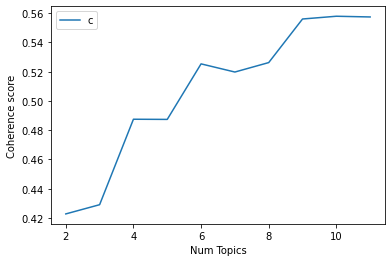

In [167]:
limit=12; start=2; step=1;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [168]:
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.4228
Num Topics = 3  has Coherence Value of 0.4291
Num Topics = 4  has Coherence Value of 0.4875
Num Topics = 5  has Coherence Value of 0.4874
Num Topics = 6  has Coherence Value of 0.5253
Num Topics = 7  has Coherence Value of 0.5198
Num Topics = 8  has Coherence Value of 0.5262
Num Topics = 9  has Coherence Value of 0.556
Num Topics = 10  has Coherence Value of 0.5579
Num Topics = 11  has Coherence Value of 0.5574


In [169]:
optimal_model = model_list[5]
model_topics = optimal_model.show_topics(formatted=False)
pprint(optimal_model.print_topics(num_words=10))

[(0,
  '0.115*"tener" + 0.029*"entender" + 0.027*"obviamente" + 0.019*"primero" + '
  '0.017*"caso" + 0.015*"enfrentar" + 0.015*"venir" + 0.015*"discusión" + '
  '0.014*"verdad" + 0.013*"valor"'),
 (1,
  '0.054*"año" + 0.025*"ahora" + 0.022*"ir" + 0.021*"bien" + 0.020*"hoy" + '
  '0.020*"idea" + 0.018*"ahí" + 0.017*"fondo" + 0.017*"exportación" + '
  '0.016*"último"'),
 (2,
  '0.029*"tener" + 0.024*"hablar" + 0.023*"importante" + 0.023*"creer" + '
  '0.022*"capacidad" + 0.020*"decir" + 0.019*"vez" + 0.019*"oportunidad" + '
  '0.018*"desafío" + 0.017*"ciudad"'),
 (3,
  '0.030*"próximo" + 0.030*"tener" + 0.030*"energía" + 0.020*"saber" + '
  '0.020*"poner" + 0.018*"día" + 0.018*"año" + 0.016*"dar" + 0.016*"nivel" + '
  '0.015*"proceso"'),
 (4,
  '0.043*"sector" + 0.029*"además" + 0.029*"hacer" + 0.027*"argentino" + '
  '0.022*"generar" + 0.022*"término" + 0.020*"dólares" + 0.020*"programa" + '
  '0.017*"querer" + 0.016*"gas"'),
 (5,
  '0.044*"millón" + 0.040*"ver" + 0.032*"adelante" + 0.

In [118]:
datos['text_lemma']

0                          [virtud, encontrar]
1       [sinceridad, brutal, difícil, difícil]
2      [creer, dejar, decir, legado, negativo]
3              [profundizar, muchísimo, pelea]
4                         [hacer, bien, mundo]
                        ...                   
246              [romper, árbol, puerta, casa]
247                            [pedir, perdón]
248                       [hacer, mejor, cosa]
249                                         []
250                                   [gracia]
Name: text_lemma, Length: 251, dtype: object

In [130]:
import pandas as pd
from collections import Counter
import nltk
nltk.download('punkt')  

df = pd.DataFrame(datos['text_lemma'])

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [131]:
tokens = df['text_lemma'].apply(lambda x: [word.lower() for word in x])  # convert all words to lowercase


In [132]:
tokens

0                          [virtud, encontrar]
1       [sinceridad, brutal, difícil, difícil]
2      [creer, dejar, decir, legado, negativo]
3              [profundizar, muchísimo, pelea]
4                         [hacer, bien, mundo]
                        ...                   
246              [romper, árbol, puerta, casa]
247                            [pedir, perdón]
248                       [hacer, mejor, cosa]
249                                         []
250                                   [gracia]
Name: text_lemma, Length: 251, dtype: object

In [135]:



words = [word for sublist in tokens for word in sublist] 
word_counts = Counter(words)

print(word_counts.most_common(20))



[('tener', 22), ('hacer', 13), ('gente', 13), ('decir', 12), ('mujer', 10), ('creer', 9), ('ministerio', 9), ('plan', 8), ('verdad', 7), ('gobierno', 7), ('pasar', 7), ('gustar', 6), ('tema', 6), ('junto', 6), ('cambio', 6), ('cosa', 6), ('virtud', 5), ('encontrar', 5), ('muchísimo', 5), ('hoy', 5)]


In [335]:
arc_name=['larreta_1.csv',
         'larreta_2.csv',
         'larreta_3.csv',
         'larreta_4.csv',
         'larreta_5.csv',
         'massa_1.csv',
         'massa_2.csv',
         'massa_3.csv',
         'massa_4.csv',
         'massa_5.csv',
         'massa_6.csv',]
poli=['larreta',
     'larreta',
     'larreta',
     'larreta',
     'larreta',
     'massa',
      'massa',
      'massa',
      'massa',
      'massa',
      'massa'
     ]

In [336]:
total=pd.DataFrame()
for i,j in enumerate(arc_name):
    data=pd.read_csv(j)
    data['politico']=poli[i]
    total=total.append(data)

In [337]:
total

,start,end,text,politico
0,0.00,2.00,Estamos con Horacio Ro... ¿Qué hace eso Horacio?,larreta
1,2.00,3.00,"Horacio, las por...",larreta
2,3.00,4.00,¿Cómo están? Bien,larreta
3,4.00,5.00,"Viste Luis, subiste",larreta
4,5.00,7.00,"Bien, está bien, te ves el micrófono por el d...",larreta
...,...,...,...,...
202,894.08,896.48,"nos quedan 20 días de trabajo,",massa
203,896.56,898.00,"porque el 1º de abril,",massa
204,898.08,902.24,con competitividad cambiaria que pone el Esta...,massa
205,902.32,904.44,tenemos que tener más vino argentino en el mu...,massa


In [338]:
total.to_csv('larreta_massa_total.csv', index=False)

In [479]:
total=pd.read_csv('larreta_massa_total.csv')

In [194]:
milei['otro']=milei.columns

In [205]:
milei_2=pd.DataFrame()

In [221]:
milei_2['nose']=pd.DataFrame(milei['otro'])

In [225]:
tot_milei=pd.DataFrame(milei_2['nose']).drop(0)

In [231]:
tot_milei=pd.DataFrame(tot_milei['nose'].str.split('.',expand=True)).melt(var_name='Column', value_name='Values')

In [236]:
milei_final=pd.DataFrame(tot_milei['Values'])

In [240]:
milei_final.columns=['text']

In [243]:
milei_final=milei_final.drop(1191)

In [190]:
milei=pd.read_table('milei_textos_summarize.txt')

EmptyDataError: No columns to parse from file

In [334]:
total

,start,end,text,politico,tokens


In [246]:
milei_final['start']=[i for i in range(len(milei_final))]

In [248]:
milei_final['end']=[i for i in range(len(milei_final))]

In [251]:
milei_final['politico']=['milei']*len(milei_final)

In [255]:
order=['start','end','text','politico']

In [257]:
milei_final=milei_final[order]

In [436]:
total=total.append(milei_final)

In [480]:
total=total[total['politico']=='larreta']

In [481]:
total

,start,end,text,politico
0,0.0,2.0,Estamos con Horacio Ro... ¿Qué hace eso Horacio?,larreta
1,2.0,3.0,"Horacio, las por...",larreta
2,3.0,4.0,¿Cómo están? Bien,larreta
3,4.0,5.0,"Viste Luis, subiste",larreta
4,5.0,7.0,"Bien, está bien, te ves el micrófono por el d...",larreta
...,...,...,...,...
3791,3070.0,3072.0,"que es el discurso anti-grieta,",larreta
3792,3072.0,3074.0,volvió a insistir sobre esto,larreta
3793,3074.0,3077.0,y sobre la necesidad de conciliación,larreta
3794,3077.0,3078.0,y concordia entre los argentinos.,larreta


In [170]:
from tqdm import tqdm
tqdm.pandas()

In [438]:
total=total.reset_index(drop=True)

In [482]:
tokens = []
batch_size=300 # Proceso en bloques de 300 documento. Este limite es para podes procesarlo con solo 8GB de ram
removal= ['ADV','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM','AUX'] # Solo me quedo con verbos, adjetivos, sustantivos y auxiliares
not_rem=['NOUN', 'ADJ', 'VERB', 'ADV']
for batch_number, batch_df in tqdm(list(total.groupby(np.arange(len(total)) // batch_size))): # Itero por cada batch
    for summary in nlp.pipe(batch_df['text']): # Itero por cada documento
        #proj_tok = [token.lemma_.lower() for token in summary if token.pos_ not in removal and not token.is_stop and token.is_alpha]
        proj_tok = [token.lemma_.lower() for token in summary if token.pos_  in not_rem and not token.is_stop and token.is_alpha and token.lemma_.lower() not in stop_creat]
        tokens.append(proj_tok)
total['tokens']=tokens

100%|███████████████████████████████████████████| 13/13 [00:08<00:00,  1.59it/s]


In [483]:
tr=[]
for i in range(len(total)):
    tr.append(len(total['tokens'][i])!=0)

In [484]:
total=total[tr].reset_index(drop=True)

In [485]:
dictionary = Dictionary(total['tokens'])

In [487]:
dictionary.filter_extremes(no_below=5, no_above=0.5, keep_n=1500) # Regla dura para limpiar los mas y lo menos frecuente

In [488]:
corpus = [dictionary.doc2bow(doc) for doc in total['tokens']]

In [489]:
from gensim.corpora.dictionary import Dictionary
from gensim.models import LdaMulticore,LdaModel
from gensim.models import CoherenceModel

In [490]:
topics = []
score = []
for i in tqdm(range(1,10,1)): # Busqueda de la cantidad de topicos
    lda_model = LdaMulticore(corpus=corpus, id2word=dictionary, iterations=300, num_topics=i, passes=300, random_state=100)
    cm = CoherenceModel(model=lda_model, texts = total['tokens'], corpus=corpus, dictionary=dictionary, coherence='c_v')
    cm = cm.get_coherence()
    print(f"cm {cm}")
    topics.append(i)
    score.append(cm)

  0%|                                                     | 0/9 [00:05<?, ?it/s]

KeyboardInterrupt

Traceback (most recent call last):
  File "<string>", line 1, in <module>
  File "/opt/anaconda3/lib/python3.8/multiprocessing/spawn.py", line 116, in spawn_main
    exitcode = _main(fd, parent_sentinel)
  File "/opt/anaconda3/lib/python3.8/multiprocessing/spawn.py", line 126, in _main
    self = reduction.pickle.load(from_parent)
  File "/opt/anaconda3/lib/python3.8/site-packages/gensim/__init__.py", line 11, in <module>
  File "/opt/anaconda3/lib/python3.8/site-packages/gensim/models/__init__.py", line 7, in <module>
    from .coherencemodel import CoherenceModel  # noqa:F401
  File "/opt/anaconda3/lib/python3.8/site-packages/gensim/models/coherencemodel.py", line 37, in <module>
    from gensim.topic_coherence import (
  File "/opt/anaconda3/lib/python3.8/site-packages/gensim/topic_coherence/probability_estimation.py", line 11, in <module>
    from gensim.topic_coherence.text_analysi

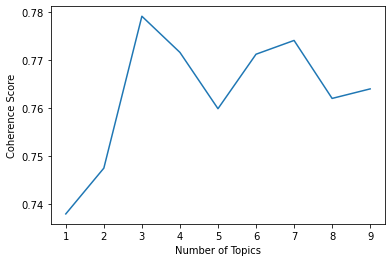

In [472]:
import matplotlib.pyplot as plt
_=plt.plot(topics, score)
_=plt.xlabel('Number of Topics')
_=plt.ylabel('Coherence Score')
plt.show()

In [473]:
idx_best_score = np.argmax(score)
best_topics = topics[idx_best_score]
f"Best score {score[idx_best_score]} with num_topics {best_topics}"

'Best score 0.7790644052381439 with num_topics 3'

In [491]:
lda_model = LdaMulticore(corpus=corpus, id2word=dictionary, iterations=50, num_topics=3, workers = 4, passes=10)

In [400]:
import spacy
import pandas as pd
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

In [551]:
vis_data = gensimvis.prepare(lda_model, corpus, dictionary)
pyLDAvis.display(vis_data)

In [494]:
pprint(lda_model.print_topics(num_words=15))

[(0,
  '0.107*"gente" + 0.029*"policía" + 0.024*"seguridad" + 0.021*"historia" + '
  '0.020*"política" + 0.020*"paz" + 0.020*"violencia" + 0.015*"equipo" + '
  '0.015*"grieta" + 0.013*"tecnología" + 0.013*"clase" + 0.012*"paso" + '
  '0.012*"manifestación" + 0.012*"caso" + 0.011*"camino"'),
 (1,
  '0.043*"plan" + 0.021*"educación" + 0.020*"salud" + 0.018*"capital" + '
  '0.016*"transformación" + 0.016*"ir" + 0.016*"candidato" + 0.015*"barrio" + '
  '0.015*"campaña" + 0.014*"laburo" + 0.014*"público" + 0.014*"gobierno" + '
  '0.014*"futuro" + 0.014*"mañana" + 0.014*"desarrollo"'),
 (2,
  '0.045*"trabajo" + 0.028*"cambio" + 0.019*"presidente" + 0.016*"escuela" + '
  '0.016*"social" + 0.016*"político" + 0.016*"escuchar" + 0.015*"situación" + '
  '0.015*"dialogar" + 0.015*"oportunidad" + 0.014*"experiencia" + '
  '0.014*"solución" + 0.013*"semana" + 0.013*"delito" + 0.012*"discusión"')]


In [478]:
stop_creat=['argentino','ciudad','that','vo','país','argentina','provincia','año','tener','tema','tomar','hacer','decisión','momento','sacar','millón','decir','pasar','necesitar','llegar','entender','obviamente','volver','gracias','cosa','ver','querer','venir','hablar','acá','poner','mirar','mes','dejar','mejorar','tenés','seguir','pensar','tiempo','mundo','lugar','importante','generar','vida','trabajar','salir','chico','pedir','vivir','preguntar','hora','cambiar','terminar','problema','bajar','ejemplo']

0              subir
1          micrófono
1           abrigulo
2           perfecto
3           micrófón
            ...     
3178        discurso
3179        insistir
3180       necesidad
3180    conciliación
3181       concordia
Name: tokens, Length: 6684, dtype: object

In [515]:
pd.DataFrame(total.explode('tokens')['tokens'])[pd.DataFrame(total.explode('tokens')['tokens'])['tokens']!='él']['tokens']

0              subir
1          micrófono
1           abrigulo
2           perfecto
3           micrófón
            ...     
3178        discurso
3179        insistir
3180       necesidad
3180    conciliación
3181       concordia
Name: tokens, Length: 6684, dtype: object

In [536]:
text = ' '.join(pd.DataFrame(total.explode('tokens')['tokens'])[pd.DataFrame(total.explode('tokens')['tokens'])['tokens']!='él']['tokens'])


In [508]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [547]:
exclude_word = 'él'


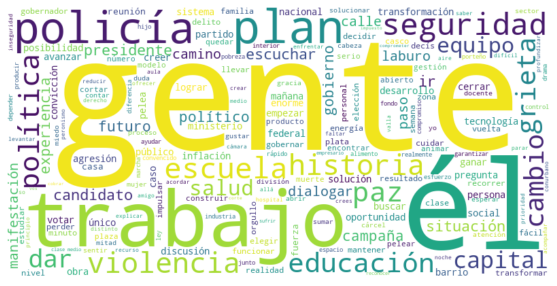

In [549]:
# Combine all tokens into a single string
text = ' '.join(pd.DataFrame(total.explode('tokens')['tokens'])[pd.DataFrame(total.explode('tokens')['tokens'])['tokens']!='él']['tokens'])

# Generate the word cloud
wordcloud = WordCloud(stopwords=exclude_word,width=800, height=400,background_color='white').generate(text)

# Plot the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear',)
plt.axis('off')
plt.show()

In [554]:
from transformers import pipeline


In [552]:
# pose sequence as a NLI premise and label as a hypothesis
from transformers import AutoModelForSequenceClassification, AutoTokenizer
nli_model = AutoModelForSequenceClassification.from_pretrained('facebook/bart-large-mnli')
tokenizer = AutoTokenizer.from_pretrained('facebook/bart-large-mnli')

Downloading:   0%|          | 0.00/1.15k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.63G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [ ]:
from transformers import pipeline
from transformers import AutoTokenizer, AutoModelForSequenceClassification
tokenizer = AutoTokenizer.from_pretrained("facebook/bart-large-mnli")
model = AutoModelForSequenceClassification.from_pretrained("facebook/bart-large-mnli")

zsc = pipeline(task='zero-shot-classification', tokenizer=tokenizer, model=model)

In [555]:
model=nli_model
zsc = pipeline(task='zero-shot-classification', tokenizer=tokenizer, model=model)

In [556]:
#sequences = oraciones[0]
candidate_labels = ['Gobierno','Socialismo','Pobreza','Mercado','Capitalismo','Desarrollo','Competencia','Inflación','Deuda','Reformas','Derechos','Justicia','Seguridad','Educación','Trabajo']


In [558]:
total['text']

0                                     Viste Luis, subiste
1        Bien, está bien, te ves el micrófono por el d...
2                              Sí, perfecto, sí, ahí está
3         Así hablan los micrófones, ¿cómo es la Horacio?
4        Bien, bien, trabajando mucho, pero bien, intenso
                              ...                        
3177     de lo que fue su spot de lanzamiento de campa...
3178                      que es el discurso anti-grieta,
3179                         volvió a insistir sobre esto
3180                 y sobre la necesidad de conciliación
3181                    y concordia entre los argentinos.
Name: text, Length: 3182, dtype: object

In [560]:
df = pd.DataFrame(total['text'], columns=['Oraciones'])


In [561]:
def topic_result(text):
    result = zsc(sequences=text, candidate_labels=candidate_labels)
    # Obtener el índice del máximo score
    indice_max_score = result['scores'].index(max(result['scores']))
    # Obtener el label correspondiente al máximo score
    label_max_score = result['labels'][indice_max_score]
    return label_max_score

,start,end,text,politico,tokens,Topic
0,4.0,5.0,"Viste Luis, subiste",larreta,[subir],Socialismo
1,5.0,7.0,"Bien, está bien, te ves el micrófono por el d...",larreta,"[micrófono, abrigulo]",Trabajo
2,7.0,8.0,"Sí, perfecto, sí, ahí está",larreta,[perfecto],Competencia
3,8.0,10.0,"Así hablan los micrófones, ¿cómo es la Horacio?",larreta,[micrófón],Competencia
4,10.0,13.0,"Bien, bien, trabajando mucho, pero bien, intenso",larreta,[intenso],Trabajo
...,...,...,...,...,...,...
3177,3067.0,3070.0,de lo que fue su spot de lanzamiento de campa...,larreta,"[spot, lanzamiento, campaña]",Desarrollo
3178,3070.0,3072.0,"que es el discurso anti-grieta,",larreta,[discurso],Deuda
3179,3072.0,3074.0,volvió a insistir sobre esto,larreta,[insistir],Gobierno
3180,3074.0,3077.0,y sobre la necesidad de conciliación,larreta,"[necesidad, conciliación]",Competencia


In [ ]:
total['Topic'] = total['text'].apply(topic_result)

In [570]:
topics_grouped = total.groupby('Topic').count().sort_values('text',ascending=False).reset_index()

In [578]:
topics_grouped

,Topic,start,end,text,politico,tokens,Oraciones
0,Desarrollo,750,750,750,750,750,Desarrollo
1,Derechos,519,519,519,519,519,Derechos
2,Pobreza,386,386,386,386,386,Pobreza
3,Trabajo,269,269,269,269,269,Trabajo
4,Seguridad,268,268,268,268,268,Seguridad
5,Competencia,233,233,233,233,233,Competencia
6,Gobierno,148,148,148,148,148,Gobierno
7,Deuda,139,139,139,139,139,Deuda
8,Educación,135,135,135,135,135,Educación
9,Mercado,106,106,106,106,106,Mercado


In [579]:
topics_grouped['Oraciones']=topics_grouped['text']

In [572]:
import plotly.express as px


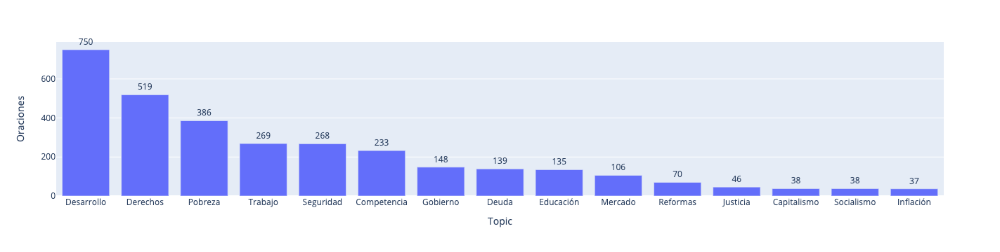

In [580]:
fig = px.bar(topics_grouped, x=topics_grouped.Topic, y=topics_grouped.Oraciones)
fig.update_traces(textposition='outside', texttemplate='%{y}', cliponaxis=False)
# Mostrar el gráfico de columnas
fig.show()

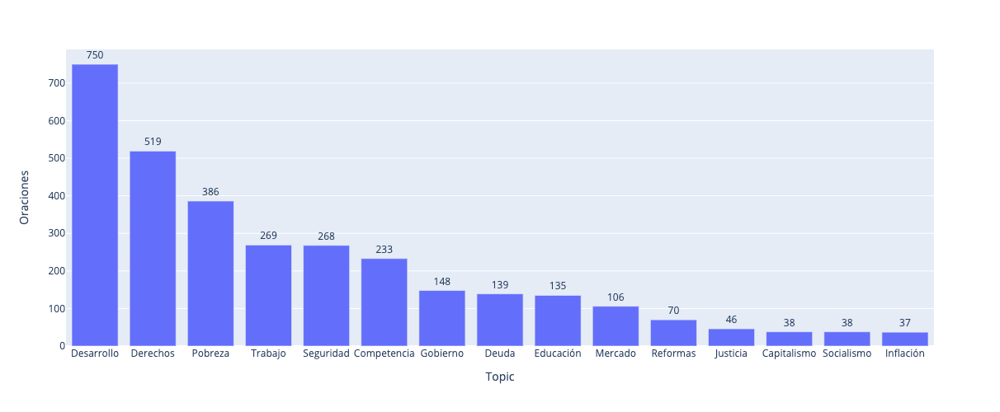

In [585]:
fig = px.bar(topics_grouped, x=topics_grouped.Topic, y=topics_grouped.Oraciones)
fig.update_traces(textposition='outside', texttemplate='%{y}', cliponaxis=False)

# Adjust the width and height
fig.update_layout(width=1100, height=500)

# Show the bar chart
fig.show()

In [586]:
sample_larr=pd.read_csv('sample_larreta.csv')

In [619]:
total.to_csv('larr_fin_fin.csv')

In [591]:
merged_df = total.merge(sample_larr, left_on='text', right_on='Oraciones', how='left')


In [596]:
merged_df=merged_df[~merged_df.Emotions.isnull()]

In [597]:
emotions_topic = merged_df.groupby(['Topic','Emotions']).count().sort_values('Oraciones',ascending=False).reset_index()

In [598]:
emotions_topic['Porcentaje'] = emotions_topic.groupby('Topic')['Oraciones'].transform(lambda x: x / x.sum() * 100)

In [605]:
emotions_topic.groupby('Emotions')['Porcentaje'].sum()

Emotions
Muy negativo    133.253669
Muy positivo    129.304474
Negativo        337.888699
Neutral          84.284376
Positivo        815.268782
Name: Porcentaje, dtype: float64

In [607]:
emotions_topic.Emotions.unique()

array(['Positivo', 'Negativo', 'Muy positivo', 'Muy negativo', 'Neutral'],
      dtype=object)

In [609]:
marker_color=[color_mapping[emotion] for emotion in emotions_topic['Emotions']]

In [613]:
emotions_topic['marker']=marker_color

In [614]:
emotions_topic

,Topic,Emotions,start,end,text,politico,tokens,Oraciones,Porcentaje,marker
0,Desarrollo,Positivo,146,146,146,146,146,146,61.344538,green
1,Derechos,Positivo,70,70,70,70,70,70,41.916168,green
2,Derechos,Negativo,58,58,58,58,58,58,34.730539,red
3,Trabajo,Positivo,58,58,58,58,58,58,72.500000,green
4,Competencia,Positivo,51,51,51,51,51,51,62.195122,green
...,...,...,...,...,...,...,...,...,...,...
65,Socialismo,Negativo,1,1,1,1,1,1,8.333333,red
66,Educación,Neutral,1,1,1,1,1,1,2.040816,gray
67,Justicia,Muy positivo,1,1,1,1,1,1,7.142857,dark-green
68,Reformas,Neutral,1,1,1,1,1,1,4.347826,gray


In [615]:
color_mapping = {
    'Muy negativo': 'darkred',
    'Negativo': 'red',
    'Neutral': 'gray',
    'Positivo': 'green',
    'Muy positivo': 'darkgreen'
}

In [617]:
emotions_topic.to_csv('emotion_larr.csv')

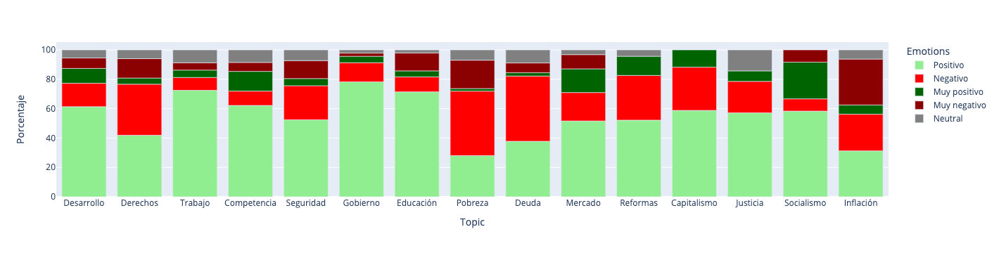

In [620]:
import plotly.express as px

color_mapping = {
    'Muy negativo': 'darkred',
    'Negativo': 'red',
    'Neutral': 'gray',
    'Positivo': 'lightgreen',
    'Muy positivo': 'darkgreen'
}

fig = px.bar(emotions_topic, x='Topic', y='Porcentaje', color='Emotions', barmode='relative',
             color_discrete_map=color_mapping)

# Show the bar chart
fig.show()